In [ ]:
!wget -q https://www.dropbox.com/s/2xltmolfbfharri/apples_oranges.zip
!unzip -q apples_oranges.zip

In [ ]:
!pip install torch_snippets torch_summary
import itertools
from PIL import Image
from torch_snippets import *
from torchvision import transforms
from torchvision.utils import make_grid
from torchsummary import summary

     |████████████████████████████████| 54 kB 3.3 MB/s 
     |████████████████████████████████| 209 kB 15.9 MB/s 
     |████████████████████████████████| 57 kB 6.2 MB/s 
     |████████████████████████████████| 51 kB 7.9 MB/s 


2021-08-07 18:59:07.435 | WARNING  | torch_snippets.torch_loader:<module>:233 - Error: No module named 'pytorch_lightning'
Not importing Lightning Report
2021-08-07 18:59:08.018 | WARNING  | torch_snippets:<module>:14 - sklearn is not found. Skipping relevant imports from submodule `sklegos`
Exception: No module named 'sklego'


In [ ]:
# Define the image Transformation pipeline


IMAGE_SIZE = 256

device = 'cuda' if torch.cuda.is_available() else 'cpu'
transform = transforms.Compose([
    transforms.Resize(int(IMAGE_SIZE*1.33)),
    transforms.RandomCrop((IMAGE_SIZE,IMAGE_SIZE)),
    transforms.RandomHorizontalFlip(),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])

In [ ]:
# Define the dataset class

class CycleGANDataset(Dataset):
    def __init__(self, apples, oranges):
        self.apples = Glob(apples)
        self.oranges = Glob(oranges)

    def __getitem__(self, ix):
        apple = self.apples[ix % len(self.apples)]
        orange = choose(self.oranges)
        apple = Image.open(apple).convert('RGB')
        orange = Image.open(orange).convert('RGB')
        return apple, orange

    def __len__(self): return max(len(self.apples), len(self.oranges))
    def choose(self): return self[randint(len(self))]

    def collate_fn(self, batch):
        srcs, trgs = list(zip(*batch))
        srcs = torch.cat([transform(img)[None] for img in srcs], 0).to(device).float()
        trgs = torch.cat([transform(img)[None] for img in trgs], 0).to(device).float()
        return srcs.to(device), trgs.to(device)

In [ ]:
trn_ds = CycleGANDataset('apples_train','oranges_train')
val_ds = CycleGANDataset('apples_test','oranges_test')

trn_dl = DataLoader(trn_ds , batch_size=1, shuffle=True,collate_fn= trn_ds.collate_fn)
val_dl = DataLoader(val_ds , batch_size= 5 , shuffle=True,collate_fn= val_ds.collate_fn)

2021-08-07 19:45:57.950 | INFO     | torch_snippets.paths:inner:24 - 3067 files found at apples_train
2021-08-07 19:45:57.967 | INFO     | torch_snippets.paths:inner:24 - 479 files found at oranges_train
2021-08-07 19:45:57.975 | INFO     | torch_snippets.paths:inner:24 - 1021 files found at apples_test
2021-08-07 19:45:57.983 | INFO     | torch_snippets.paths:inner:24 - 160 files found at oranges_test


In [ ]:
def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        torch.nn.init.normal_(m.weight.data, 0.0, 0.02)
        if hasattr(m, "bias") and m.bias is not None:
            torch.nn.init.constant_(m.bias.data, 0.0)
    elif classname.find("BatchNorm2d") != -1:
        torch.nn.init.normal_(m.weight.data, 1.0, 0.02)
        torch.nn.init.constant_(m.bias.data, 0.0)
class ResidualBlock(nn.Module):
    def __init__(self, in_features):
        super(ResidualBlock, self).__init__()

        self.block = nn.Sequential(
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features),
            nn.ReLU(inplace=True),
            nn.ReflectionPad2d(1),
            nn.Conv2d(in_features, in_features, 3),
            nn.InstanceNorm2d(in_features),
        )

    def forward(self, x):
        return x + self.block(x)

In [ ]:
class GeneratorResNet(nn.Module):
    def __init__(self, num_residual_blocks=9):
        super(GeneratorResNet, self).__init__()
        out_features = 64
        channels = 3
        model = [
            nn.ReflectionPad2d(3),
            nn.Conv2d(channels, out_features, 7),
            nn.InstanceNorm2d(out_features),
            nn.ReLU(inplace=True),
        ]
        in_features = out_features
        # Downsampling
        for _ in range(2):
            out_features *= 2
            model += [
                nn.Conv2d(in_features, out_features, 3, stride=2, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True),
            ]
            in_features = out_features

        # Residual blocks
        for _ in range(num_residual_blocks):
            model += [ResidualBlock(out_features)]

        # Upsampling
        for _ in range(2):
            out_features //= 2
            model += [
                nn.Upsample(scale_factor=2),
                nn.Conv2d(in_features, out_features, 3, stride=1, padding=1),
                nn.InstanceNorm2d(out_features),
                nn.ReLU(inplace=True),
            ]
            in_features = out_features

        # Output layer
        model += [nn.ReflectionPad2d(channels), nn.Conv2d(out_features, channels, 7), nn.Tanh()]
        self.model = nn.Sequential(*model)
        self.apply(weights_init_normal)
    def forward(self, x):
        return self.model(x)

In [ ]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()

        channels, height, width = 3, IMAGE_SIZE, IMAGE_SIZE

        def discriminator_block(in_filters, out_filters, normalize=True):
            """Returns downsampling layers of each discriminator block"""
            layers = [nn.Conv2d(in_filters, out_filters, 4, stride=2, padding=1)]
            if normalize:
                layers.append(nn.InstanceNorm2d(out_filters))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        self.model = nn.Sequential(
            *discriminator_block(channels, 64, normalize=False),
            *discriminator_block(64, 128),
            *discriminator_block(128, 256),
            *discriminator_block(256, 512),
            nn.ZeroPad2d((1, 0, 1, 0)),
            nn.Conv2d(512, 1, 4, padding=1)
        )
        self.apply(weights_init_normal)

    def forward(self, img):
        return self.model(img)

In [ ]:
@torch.no_grad()
def generate_sample():
    data = next(iter(val_dl))
    G_AB.eval()
    G_BA.eval()
    
    real_A, real_B = data
    fake_B = G_AB(real_A)
    fake_A = G_BA(real_B)
    # Arange images along x-axis
    real_A = make_grid(real_A, nrow=5, normalize=True)
    real_B = make_grid(real_B, nrow=5, normalize=True)
    fake_A = make_grid(fake_A, nrow=5, normalize=True)
    fake_B = make_grid(fake_B, nrow=5, normalize=True)
    # Arange images along y-axis
    image_grid = torch.cat((real_A, fake_B, real_B, fake_A), 1)
    show(image_grid.detach().cpu().permute(1,2,0).numpy(), sz=12)

In [ ]:
def generator_train_step(Gs, optimizer, real_A, real_B):
    G_AB, G_BA = Gs
    optimizer.zero_grad()
    loss_id_A = criterion_identity(G_BA(real_A), real_A)
    loss_id_B = criterion_identity(G_AB(real_B), real_B)

    loss_identity = (loss_id_A + loss_id_B) / 2
    fake_B = G_AB(real_A)
    loss_GAN_AB = criterion_GAN(D_B(fake_B), torch.Tensor(np.ones((len(real_A), 1, 16, 16))).to(device))
    fake_A = G_BA(real_B)
    loss_GAN_BA = criterion_GAN(D_A(fake_A), torch.Tensor(np.ones((len(real_A), 1, 16, 16))).to(device))

    loss_GAN = (loss_GAN_AB + loss_GAN_BA) / 2
    recov_A = G_BA(fake_B)
    loss_cycle_A = criterion_cycle(recov_A, real_A)
    recov_B = G_AB(fake_A)
    loss_cycle_B = criterion_cycle(recov_B, real_B)

    loss_cycle = (loss_cycle_A + loss_cycle_B) / 2
    loss_G = loss_GAN + lambda_cyc * loss_cycle + lambda_id * loss_identity
    loss_G.backward()
    optimizer.step()
    return loss_G, loss_identity, loss_GAN, loss_cycle, loss_G, fake_A, fake_B

In [ ]:
def discriminator_train_step(D, real_data, fake_data, optimizer):
    optimizer.zero_grad()
    loss_real = criterion_GAN(D(real_data), torch.Tensor(np.ones((len(real_data), 1, 16, 16))).to(device))
    loss_fake = criterion_GAN(D(fake_data.detach()), torch.Tensor(np.zeros((len(real_data), 1, 16, 16))).to(device))
    loss_D = (loss_real + loss_fake) / 2
    loss_D.backward()
    optimizer.step()
    return loss_D

In [ ]:
G_AB = GeneratorResNet().to(device)
G_BA = GeneratorResNet().to(device)
D_A = Discriminator().to(device)
D_B = Discriminator().to(device)

criterion_GAN = torch.nn.MSELoss()
criterion_cycle = torch.nn.L1Loss()
criterion_identity = torch.nn.L1Loss()

optimizer_G = torch.optim.Adam(
    itertools.chain(G_AB.parameters(), G_BA.parameters()), lr=0.0002, betas=(0.5, 0.999)
)
optimizer_D_A = torch.optim.Adam(D_A.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D_B = torch.optim.Adam(D_B.parameters(), lr=0.0002, betas=(0.5, 0.999))

lambda_cyc, lambda_id = 10.0, 5.0

EPOCH: 0.000	loss_D: 1.849	loss_G: 12.822	loss_GAN: 2.509	loss_cycle: 0.702	loss_identity: 0.660	(0.73s - 22381.46s remaining)

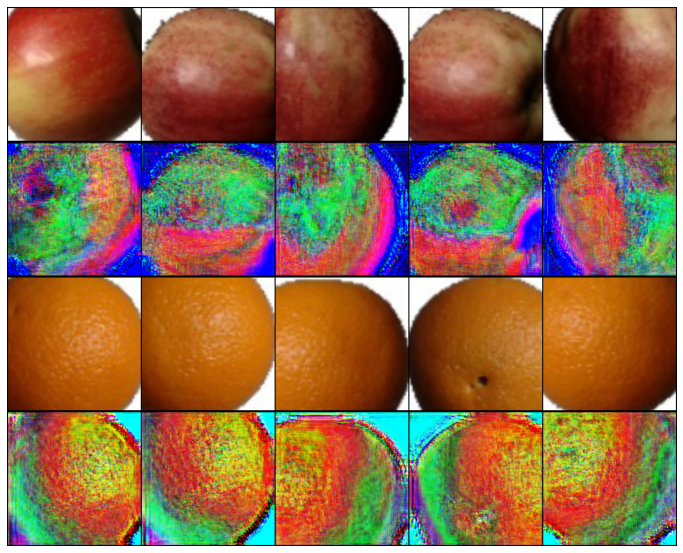

EPOCH: 0.033	loss_D: 0.209	loss_G: 2.238	loss_GAN: 0.435	loss_cycle: 0.126	loss_identity: 0.109	(65.95s - 19960.66s remaining)

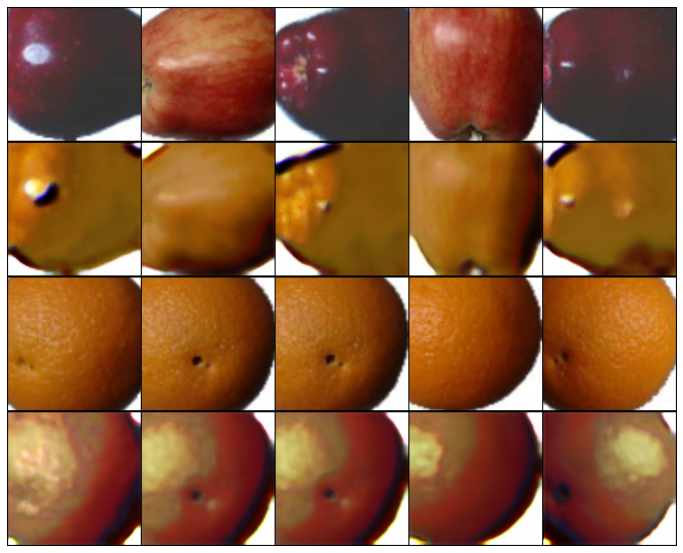

EPOCH: 0.066	loss_D: 0.116	loss_G: 2.128	loss_GAN: 0.665	loss_cycle: 0.101	loss_identity: 0.092	(133.62s - 20255.18s remaining)

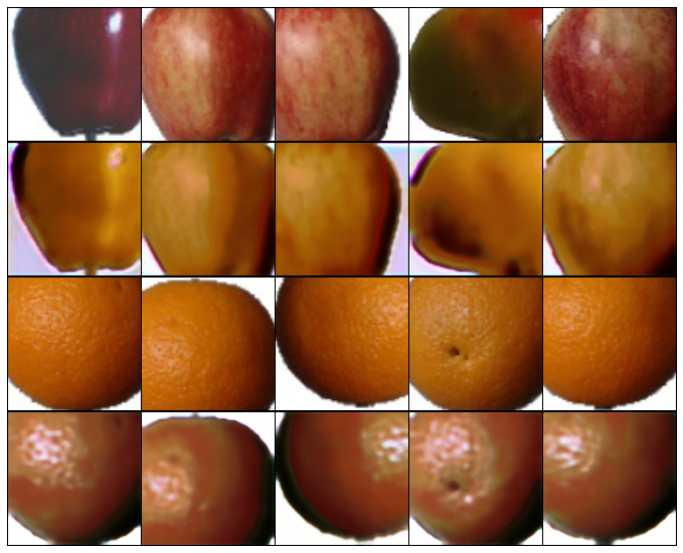

EPOCH: 0.098	loss_D: 0.280	loss_G: 2.153	loss_GAN: 0.386	loss_cycle: 0.123	loss_identity: 0.108	(202.72s - 20453.34s remaining)

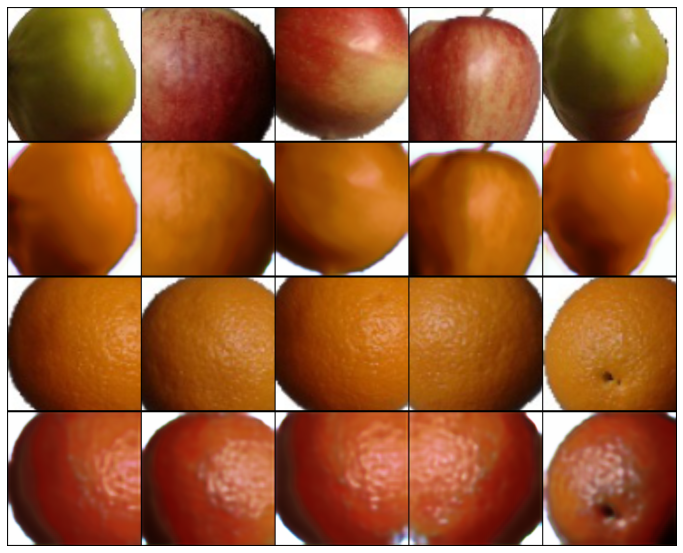

EPOCH: 0.131	loss_D: 0.364	loss_G: 2.135	loss_GAN: 0.449	loss_cycle: 0.119	loss_identity: 0.099	(272.35s - 20558.28s remaining)

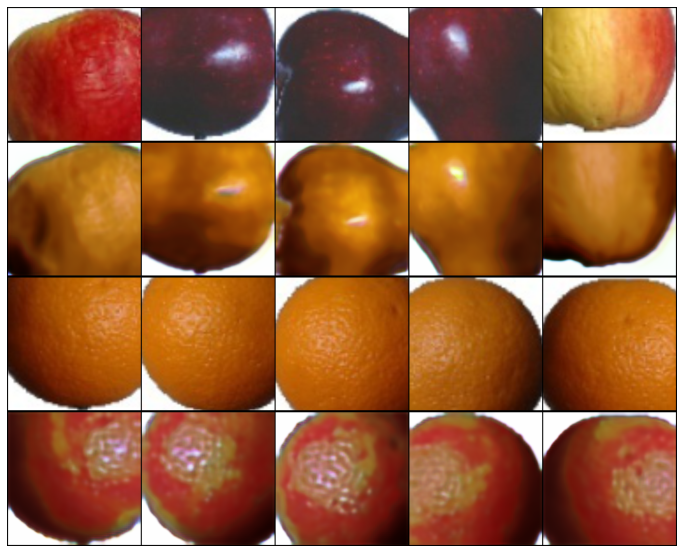

EPOCH: 0.163	loss_D: 0.177	loss_G: 2.108	loss_GAN: 0.413	loss_cycle: 0.122	loss_identity: 0.094	(342.38s - 20617.09s remaining)

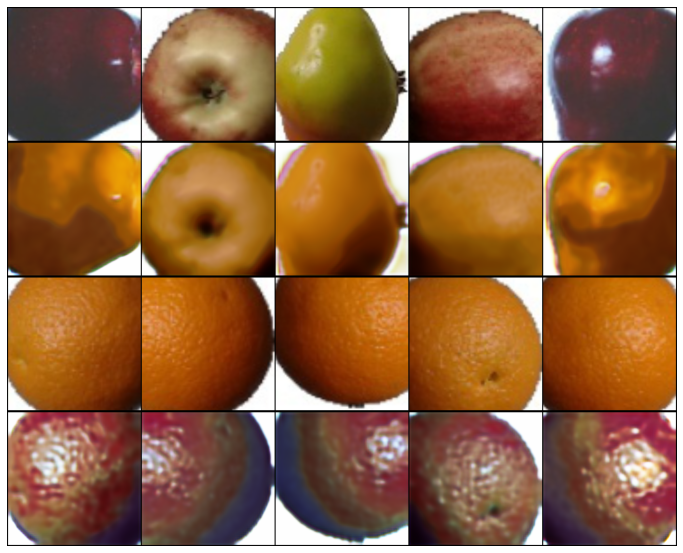

EPOCH: 0.196	loss_D: 0.164	loss_G: 2.250	loss_GAN: 0.483	loss_cycle: 0.123	loss_identity: 0.108	(412.68s - 20646.84s remaining)

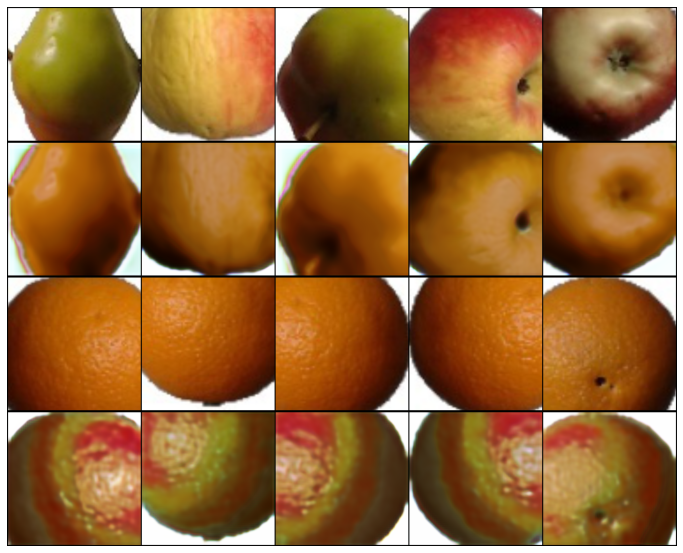

EPOCH: 0.229	loss_D: 0.302	loss_G: 2.100	loss_GAN: 0.183	loss_cycle: 0.128	loss_identity: 0.127	(482.88s - 20643.89s remaining)

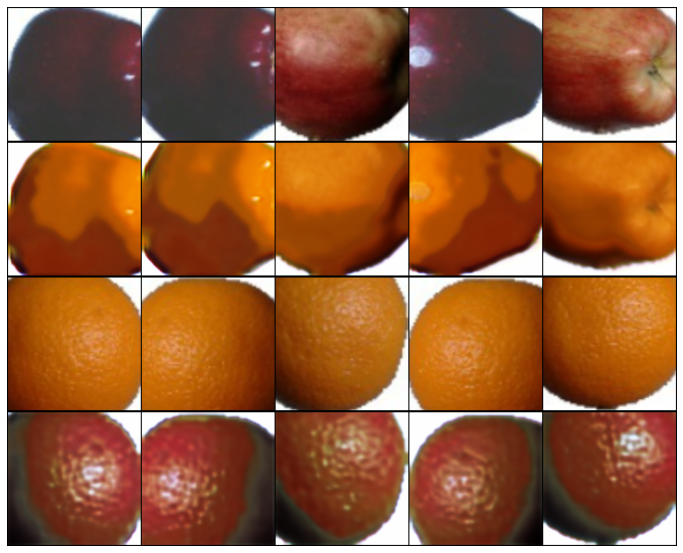

EPOCH: 0.261	loss_D: 0.228	loss_G: 3.021	loss_GAN: 0.651	loss_cycle: 0.169	loss_identity: 0.136	(553.09s - 20624.48s remaining)

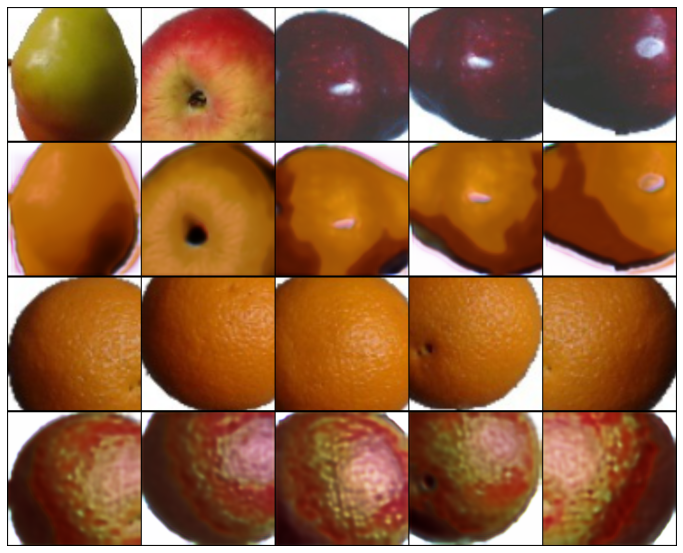

EPOCH: 0.294	loss_D: 0.173	loss_G: 2.018	loss_GAN: 0.370	loss_cycle: 0.118	loss_identity: 0.094	(623.48s - 20599.91s remaining)

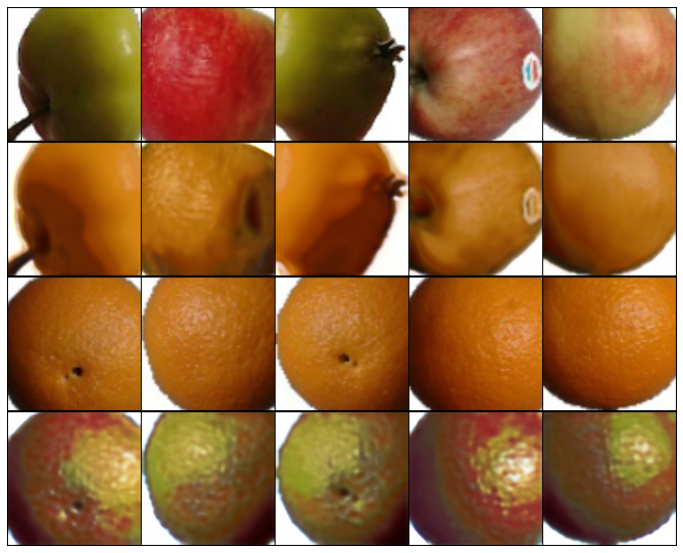

EPOCH: 0.326	loss_D: 0.189	loss_G: 2.038	loss_GAN: 0.662	loss_cycle: 0.096	loss_identity: 0.084	(694.09s - 20572.44s remaining)

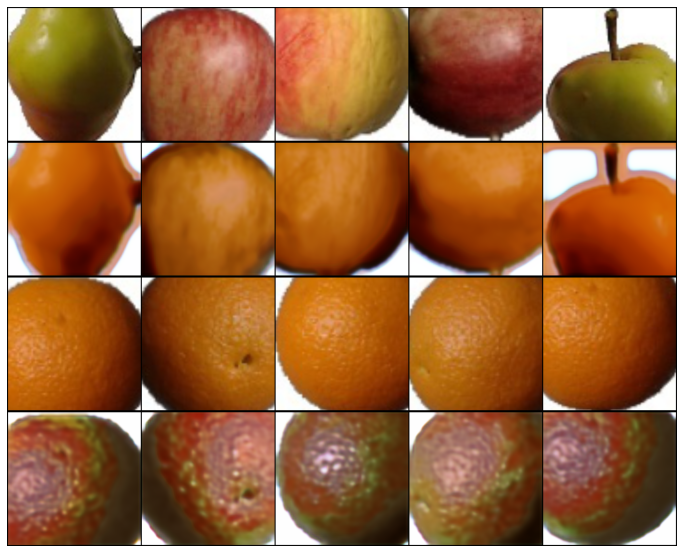

EPOCH: 0.359	loss_D: 0.454	loss_G: 2.352	loss_GAN: 0.452	loss_cycle: 0.123	loss_identity: 0.135	(764.76s - 20538.73s remaining)

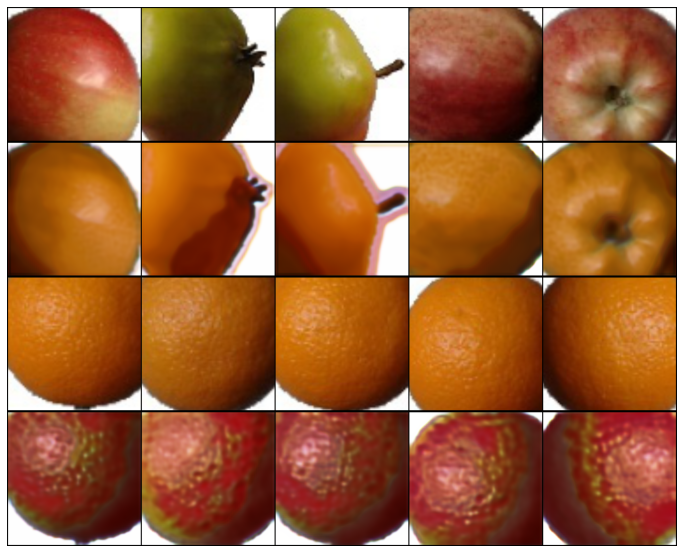

EPOCH: 0.392	loss_D: 0.254	loss_G: 1.760	loss_GAN: 0.347	loss_cycle: 0.097	loss_identity: 0.088	(835.36s - 20497.27s remaining)

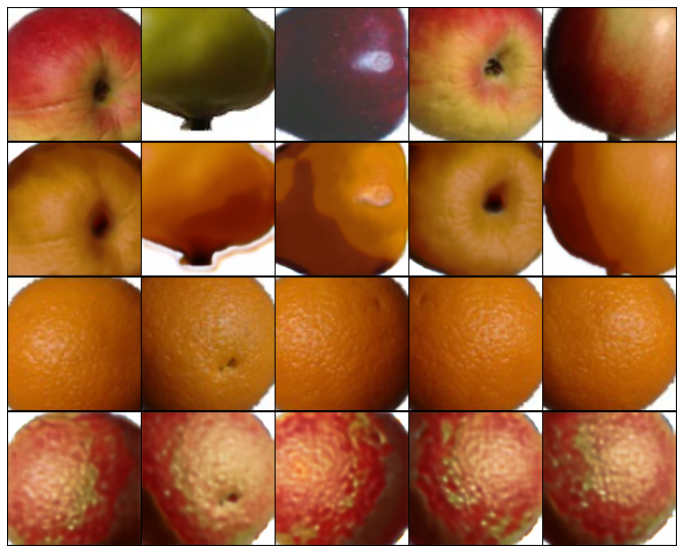

EPOCH: 0.424	loss_D: 0.292	loss_G: 1.974	loss_GAN: 0.460	loss_cycle: 0.104	loss_identity: 0.096	(905.84s - 20448.69s remaining)

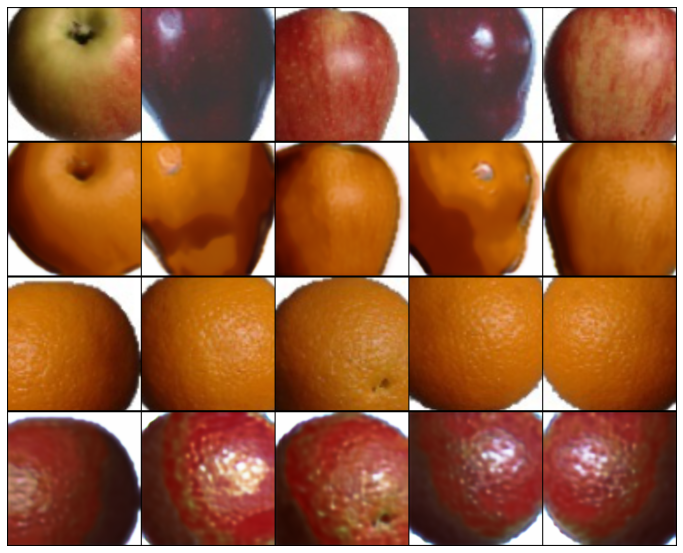

EPOCH: 0.457	loss_D: 0.227	loss_G: 2.405	loss_GAN: 0.425	loss_cycle: 0.155	loss_identity: 0.087	(976.26s - 20395.44s remaining)

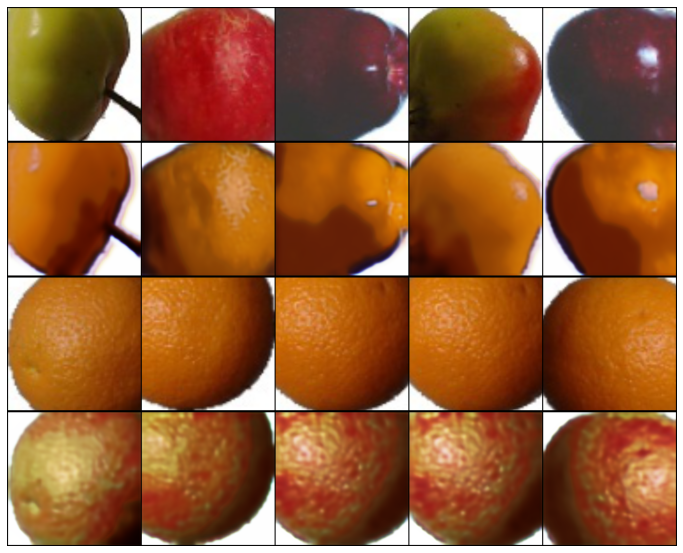

EPOCH: 0.489	loss_D: 0.215	loss_G: 2.102	loss_GAN: 0.410	loss_cycle: 0.118	loss_identity: 0.103	(1046.62s - 20339.01s remaining)

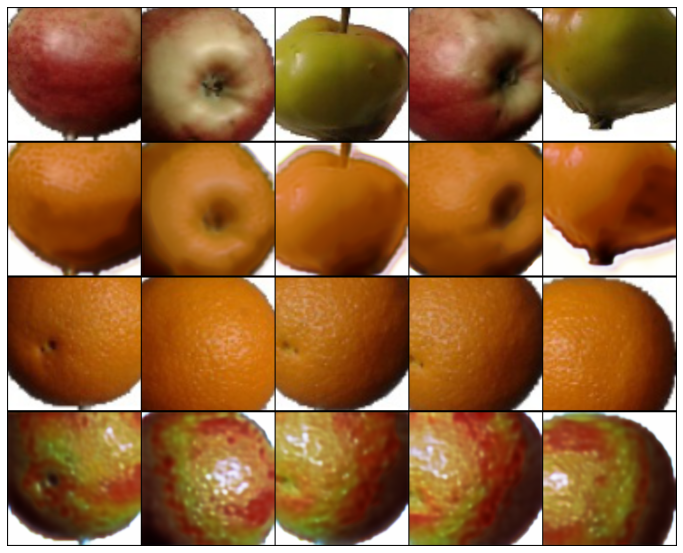

EPOCH: 0.522	loss_D: 0.173	loss_G: 2.751	loss_GAN: 0.559	loss_cycle: 0.157	loss_identity: 0.125	(1117.08s - 20282.50s remaining)

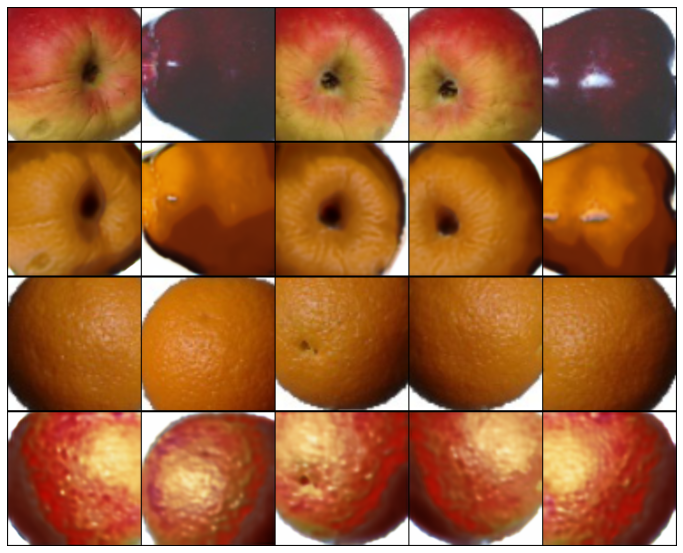

EPOCH: 0.555	loss_D: 0.169	loss_G: 1.775	loss_GAN: 0.538	loss_cycle: 0.092	loss_identity: 0.063	(1187.55s - 20224.65s remaining)

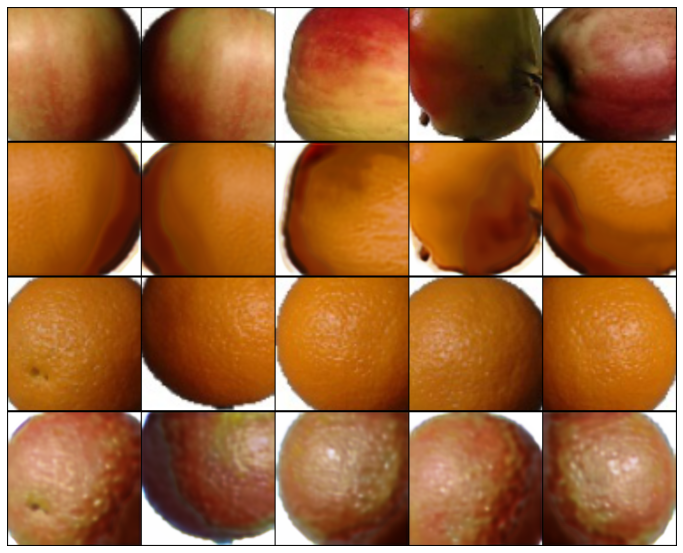

EPOCH: 0.587	loss_D: 0.224	loss_G: 2.195	loss_GAN: 0.262	loss_cycle: 0.134	loss_identity: 0.118	(1257.95s - 20164.21s remaining)

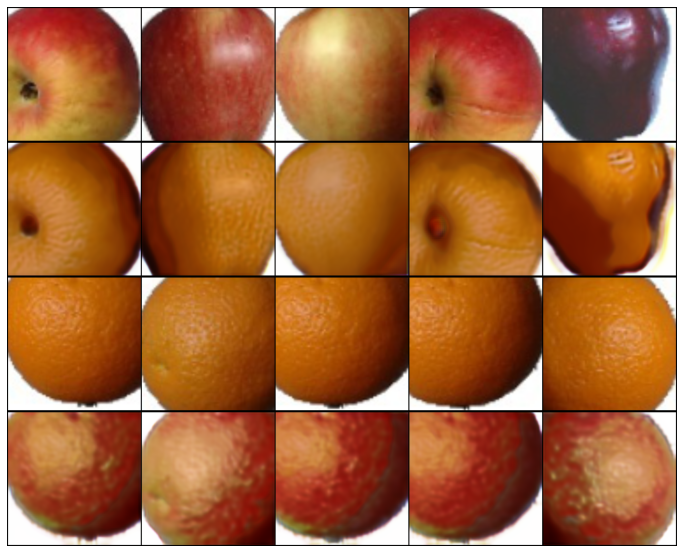

EPOCH: 0.620	loss_D: 0.141	loss_G: 3.115	loss_GAN: 0.558	loss_cycle: 0.173	loss_identity: 0.164	(1328.34s - 20102.63s remaining)

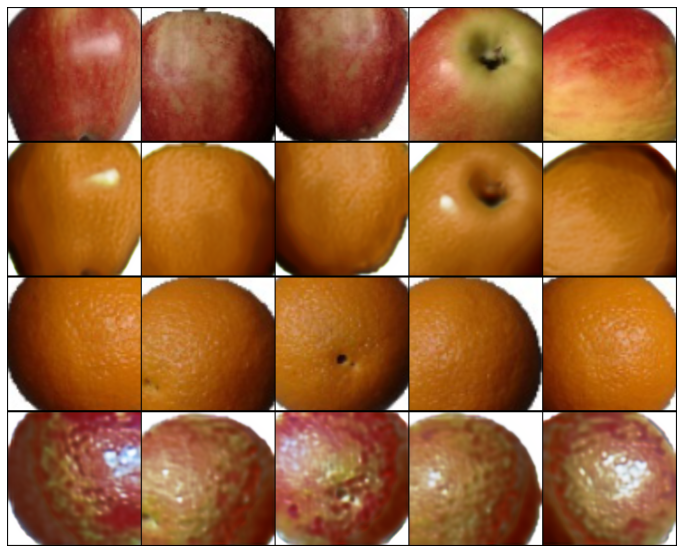

EPOCH: 0.652	loss_D: 0.146	loss_G: 3.867	loss_GAN: 0.426	loss_cycle: 0.238	loss_identity: 0.212	(1398.76s - 20040.52s remaining)

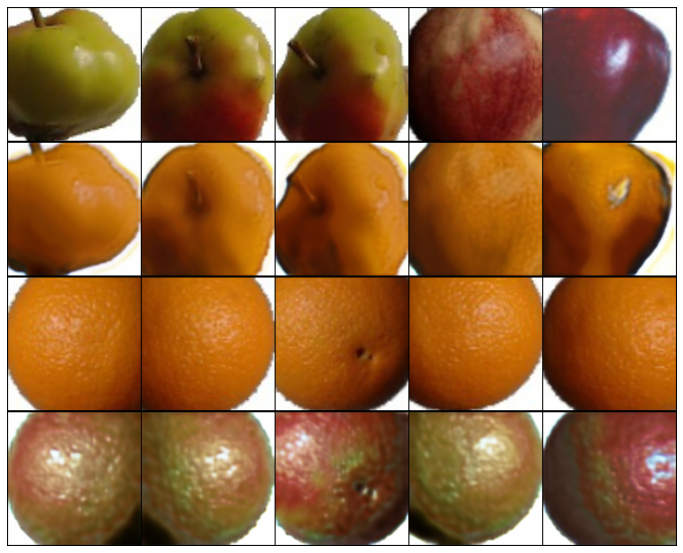

EPOCH: 0.685	loss_D: 0.172	loss_G: 1.783	loss_GAN: 0.587	loss_cycle: 0.086	loss_identity: 0.066	(1469.21s - 19978.09s remaining)

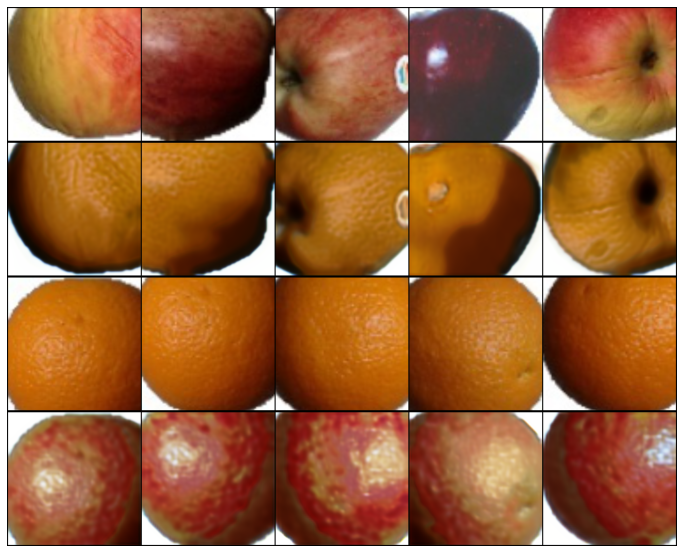

EPOCH: 0.718	loss_D: 0.148	loss_G: 1.762	loss_GAN: 0.666	loss_cycle: 0.077	loss_identity: 0.066	(1539.69s - 19915.29s remaining)

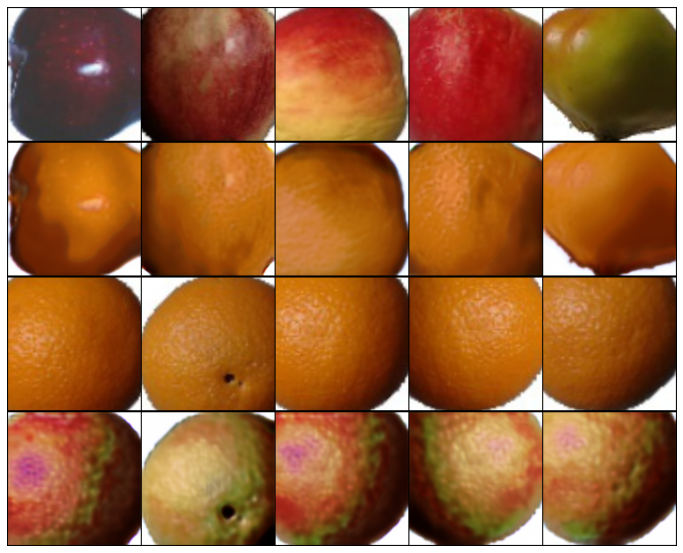

EPOCH: 0.750	loss_D: 0.220	loss_G: 1.293	loss_GAN: 0.352	loss_cycle: 0.066	loss_identity: 0.056	(1610.16s - 19851.68s remaining)

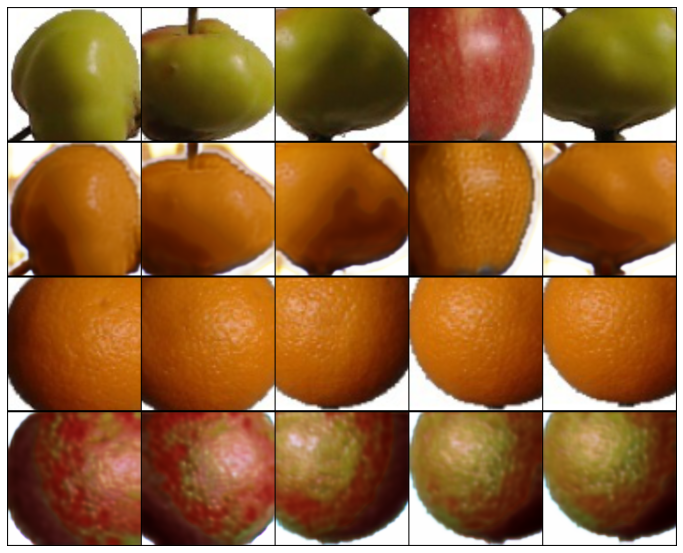

EPOCH: 0.783	loss_D: 0.186	loss_G: 1.561	loss_GAN: 0.436	loss_cycle: 0.079	loss_identity: 0.068	(1680.69s - 19788.13s remaining)

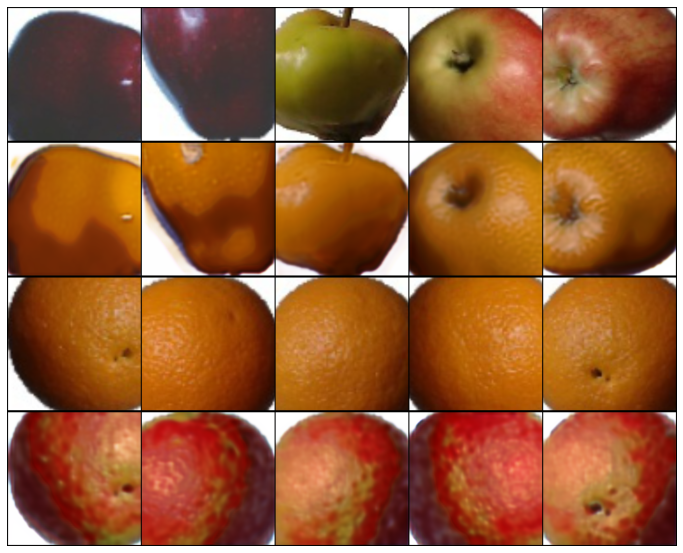

EPOCH: 0.815	loss_D: 0.139	loss_G: 1.948	loss_GAN: 0.848	loss_cycle: 0.076	loss_identity: 0.068	(1751.67s - 19729.20s remaining)

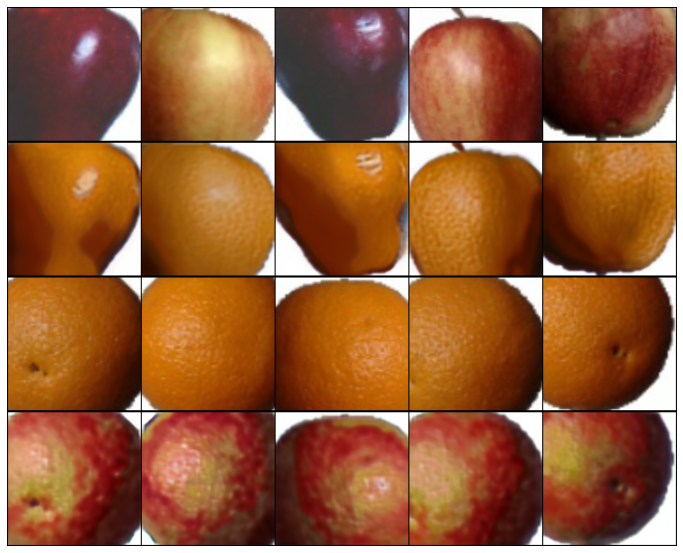

EPOCH: 0.848	loss_D: 0.300	loss_G: 1.796	loss_GAN: 0.365	loss_cycle: 0.089	loss_identity: 0.108	(1822.75s - 19670.41s remaining)

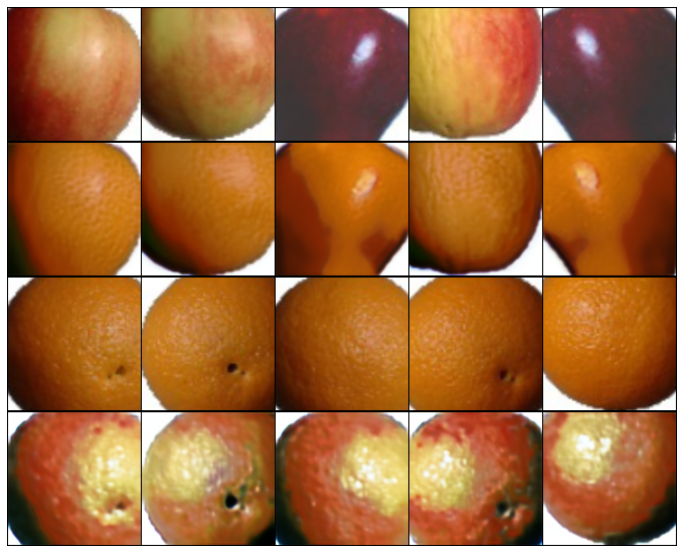

EPOCH: 0.881	loss_D: 0.271	loss_G: 1.722	loss_GAN: 0.486	loss_cycle: 0.087	loss_identity: 0.073	(1894.05s - 19613.02s remaining)

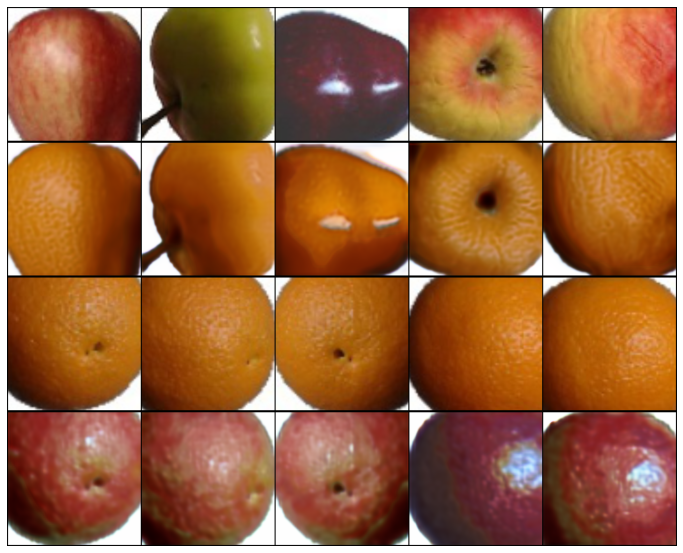

EPOCH: 0.913	loss_D: 0.188	loss_G: 2.370	loss_GAN: 0.636	loss_cycle: 0.120	loss_identity: 0.107	(1965.26s - 19553.68s remaining)

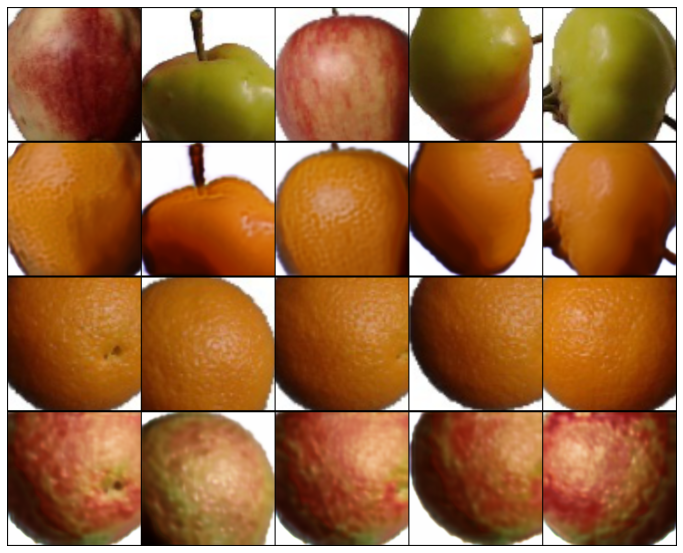

EPOCH: 0.946	loss_D: 0.272	loss_G: 1.940	loss_GAN: 0.441	loss_cycle: 0.100	loss_identity: 0.100	(2036.14s - 19490.33s remaining)

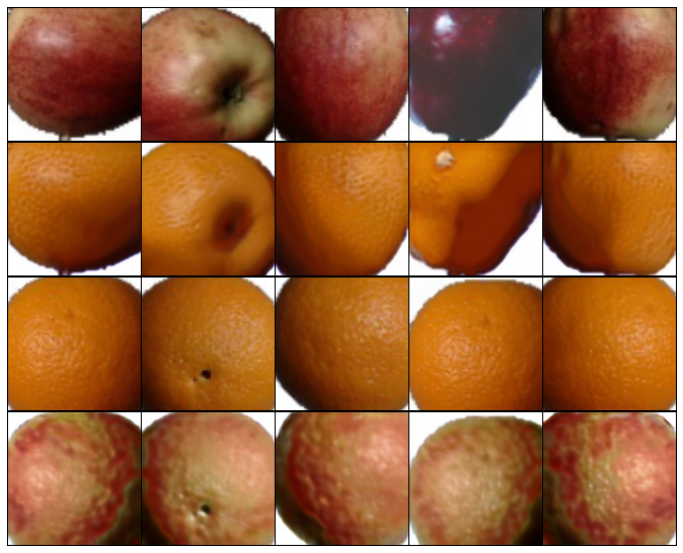

EPOCH: 0.978	loss_D: 0.310	loss_G: 1.884	loss_GAN: 0.590	loss_cycle: 0.095	loss_identity: 0.069	(2106.72s - 19423.84s remaining)

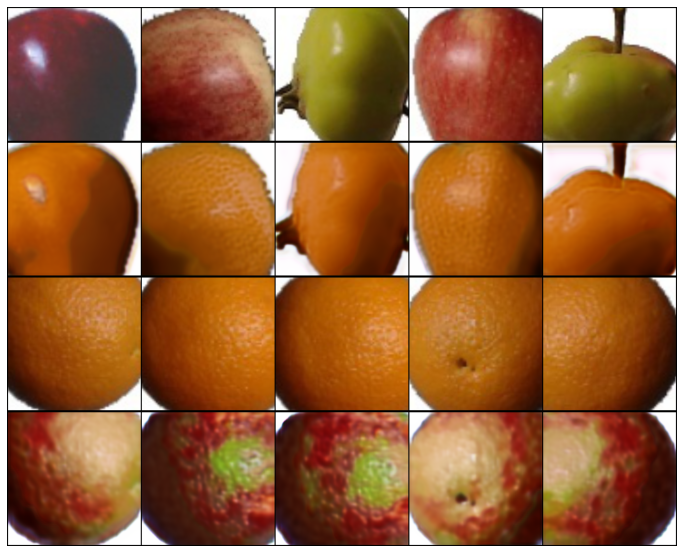

EPOCH: 1.000	loss_D: 0.233	loss_G: 2.142	loss_GAN: 0.466	loss_cycle: 0.116	loss_identity: 0.102	(2153.59s - 19382.28s remaining)
EPOCH: 1.000	loss_D: 0.204	loss_G: 1.550	loss_GAN: 0.388	loss_cycle: 0.081	loss_identity: 0.071	(2154.28s - 19381.54s remaining)

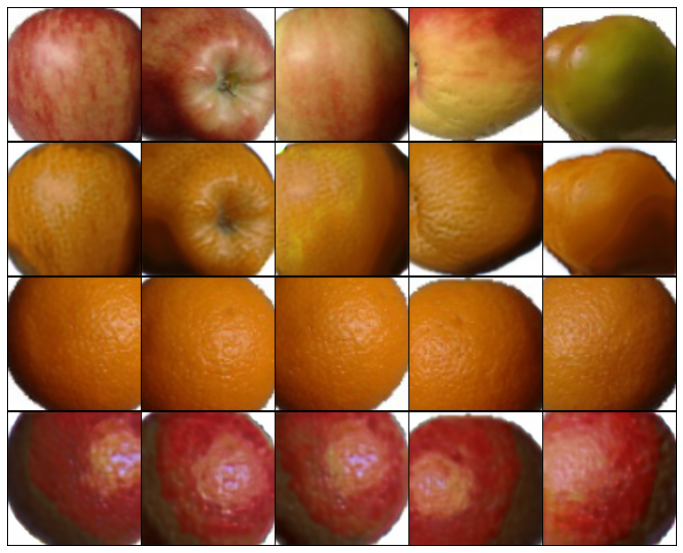

EPOCH: 1.033	loss_D: 0.114	loss_G: 1.368	loss_GAN: 0.475	loss_cycle: 0.060	loss_identity: 0.058	(2224.86s - 19314.40s remaining)

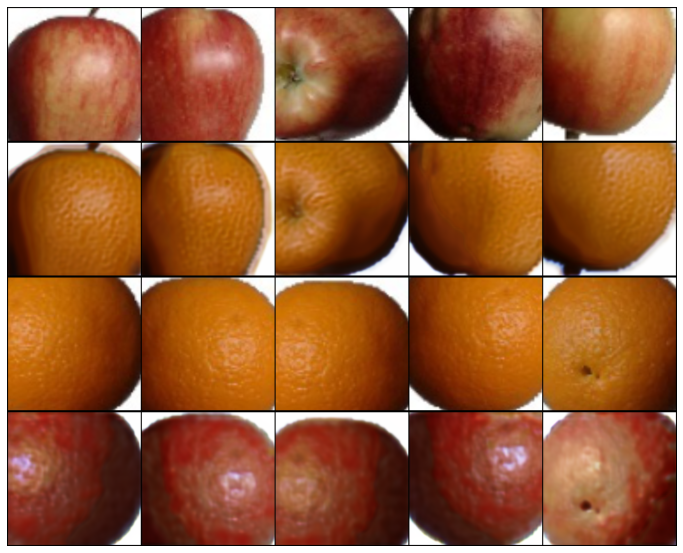

EPOCH: 1.066	loss_D: 0.093	loss_G: 1.370	loss_GAN: 0.595	loss_cycle: 0.054	loss_identity: 0.048	(2295.41s - 19246.91s remaining)

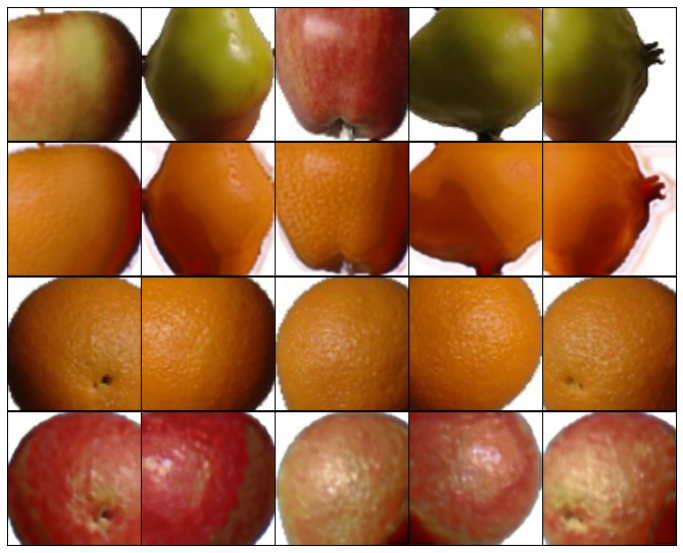

EPOCH: 1.098	loss_D: 0.166	loss_G: 1.551	loss_GAN: 0.458	loss_cycle: 0.082	loss_identity: 0.055	(2365.99s - 19179.38s remaining)

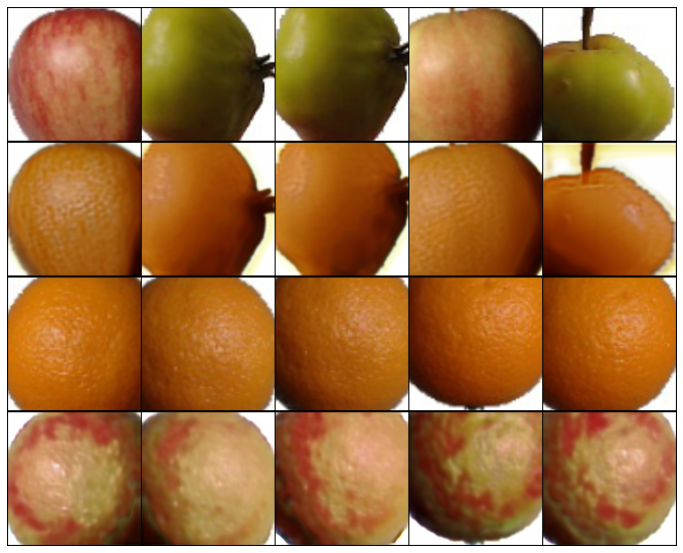

EPOCH: 1.131	loss_D: 0.083	loss_G: 1.523	loss_GAN: 0.580	loss_cycle: 0.065	loss_identity: 0.058	(2436.65s - 19112.37s remaining)

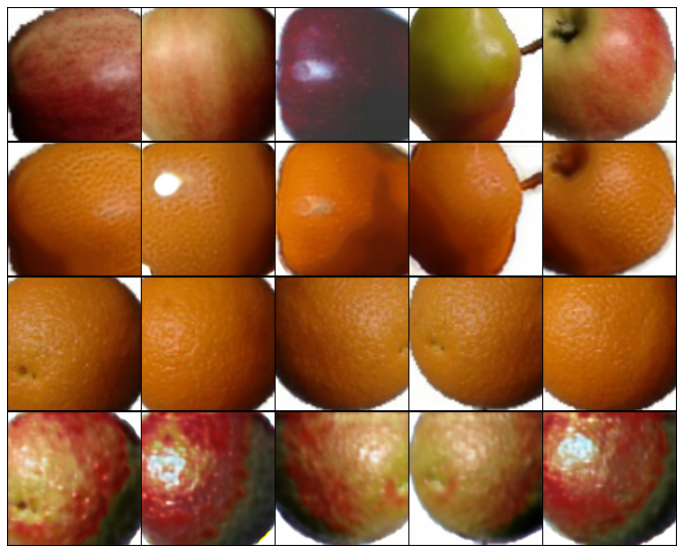

EPOCH: 1.163	loss_D: 0.064	loss_G: 1.957	loss_GAN: 0.809	loss_cycle: 0.084	loss_identity: 0.062	(2507.29s - 19044.99s remaining)

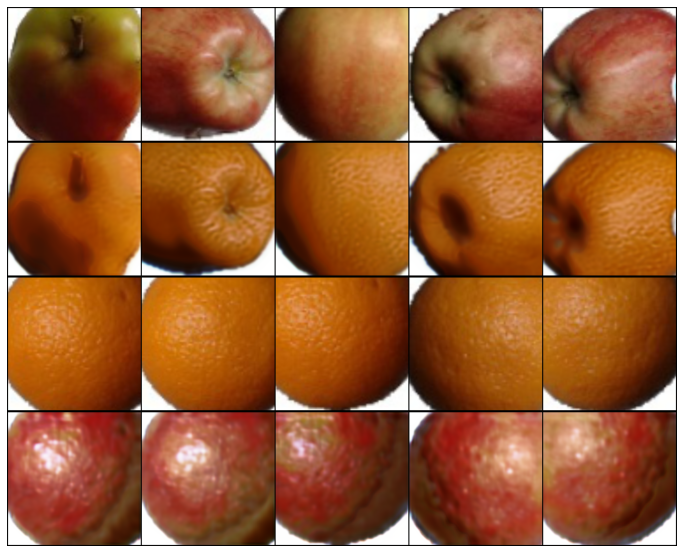

EPOCH: 1.196	loss_D: 0.451	loss_G: 1.040	loss_GAN: 0.225	loss_cycle: 0.056	loss_identity: 0.051	(2577.92s - 18977.39s remaining)

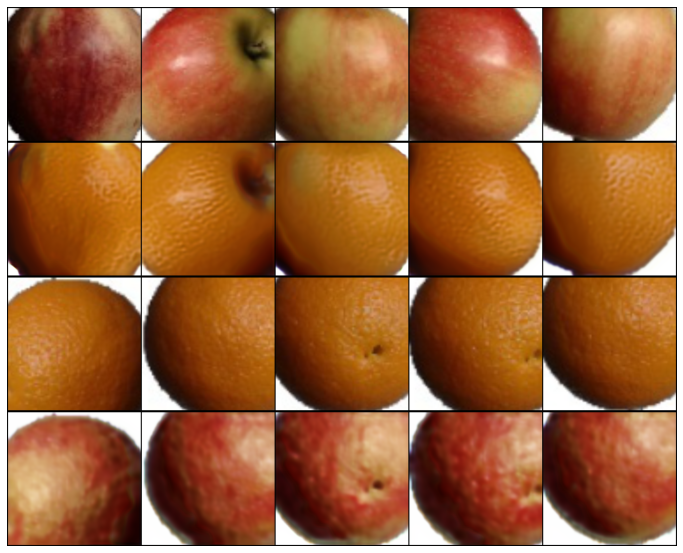

EPOCH: 1.229	loss_D: 0.130	loss_G: 1.524	loss_GAN: 0.381	loss_cycle: 0.076	loss_identity: 0.076	(2648.57s - 18909.75s remaining)

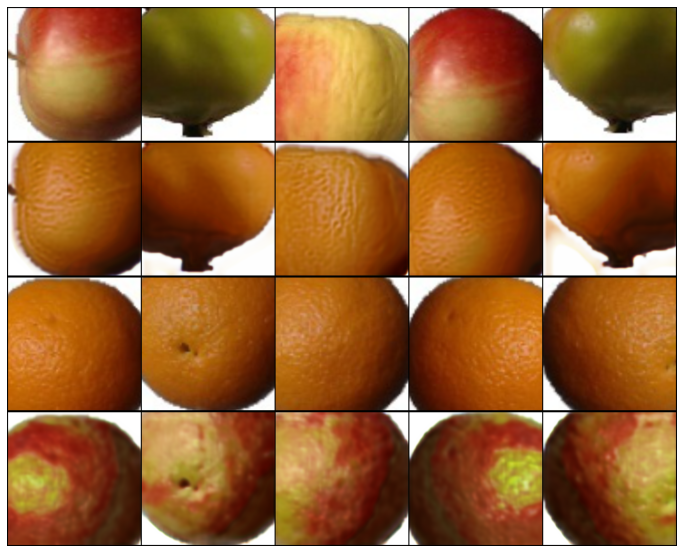

EPOCH: 1.247	loss_D: 0.113	loss_G: 2.657	loss_GAN: 0.526	loss_cycle: 0.156	loss_identity: 0.115	(2689.86s - 18872.64s remaining)

In [ ]:
n_epochs = 10
log = Report(n_epochs)
for epoch in range(n_epochs):
    N = len(trn_dl)
    for bx, batch in enumerate(trn_dl):
        real_A, real_B = batch

        loss_G, loss_identity, loss_GAN, loss_cycle, loss_G, fake_A, fake_B = generator_train_step((G_AB,G_BA), optimizer_G, real_A, real_B)
        loss_D_A = discriminator_train_step(D_A, real_A, fake_A, optimizer_D_A)
        loss_D_B = discriminator_train_step(D_B, real_B, fake_B, optimizer_D_B)
        loss_D = (loss_D_A + loss_D_B) / 2
        
        log.record(epoch+(1+bx)/N, loss_D=loss_D.item(), loss_G=loss_G.item(), 
                   loss_GAN=loss_GAN.item(), loss_cycle=loss_cycle.item(), 
                   loss_identity=loss_identity.item(), end='\r')
        if bx%100==0: generate_sample()

    log.report_avgs(epoch+1)